In [ ]:
#This notebook takes the best model .pt file genetrated by training yolov5 on FB10 data (gt_for_cell_classification) for 100epochs 
#Runs inference on 12 images used as validation set
# OBSERVATION: Number of detected cells
# [125,121,117,211,164,170,117,172,167,227,235,150] MRCNN latest
# [131,195,207,376,291,283,80,186,239,328,425,193] YOLOV5

In [11]:
import os
import shutil
import scipy
from scipy import stats
from skimage.io import imread, imsave
import numpy as np
from matplotlib import pyplot as plt

In [13]:
imgdir='/data/nissl_fetal/FB10/train/stage1_train/images'
maskdir='/data/nissl_fetal/FB10/train/stage1_train/masks'

In [1]:
HOME = os.getcwd()
print(HOME)

/workspace


In [2]:
!git clone https://github.com/ultralytics/yolov5.git # clone
%cd {HOME}/yolov5
%pip install -r requirements.txt # install

import torch
import utils
display = utils.notebook_init()

YOLOv5 🚀 v7.0-172-gc3c1304 Python-3.8.10 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)


Setup complete ✅ (8 CPUs, 7.7 GB RAM, 58.0/251.0 GB disk)


In [12]:
image_list=os.listdir('/data/nissl_fetal/FB10/train/stage1_train/val')

In [10]:
# infer using segment/predict.py
%cd {HOME}/yolov5
!python /workspace/yolov5/segment/predict.py --weights /workspace/best.pt --source ../../data/nissl_fetal/FB10/train/stage1_train/val --name inference_val --imgsz 512 --max-det 4000 --line-thickness 1 


segment/predict: weights=['/workspace/best.pt'], source=../../data/nissl_fetal/FB10/train/stage1_train/val, data=data/coco128.yaml, imgsz=[512, 512], conf_thres=0.25, iou_thres=0.45, max_det=4000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/predict-seg, name=inference_val, exist_ok=False, line_thickness=1, hide_labels=True, hide_conf=True, half=False, dnn=False, vid_stride=1, retina_masks=False
YOLOv5 🚀 v7.0-172-gc3c1304 Python-3.8.10 torch-2.0.1+cu117 CUDA:0 (NVIDIA GeForce RTX 3060 Laptop GPU, 6144MiB)

Fusing layers... 
Model summary: 165 layers, 7398422 parameters, 0 gradients, 25.7 GFLOPs
image 1/12 /data/nissl_fetal/FB10/train/stage1_train/val/14728.jpg: 512x512 131 cells, 6.6ms
image 2/12 /data/nissl_fetal/FB10/train/stage1_train/val/14729.jpg: 512x512 195 cells, 5.6ms
image 3/12 /data/nissl_fetal/FB10/train/stage1_train/val/14730.jpg: 512x512

In [15]:
yolo_out_dir='/workspace/yolov5/runs/predict-seg/inference_val'

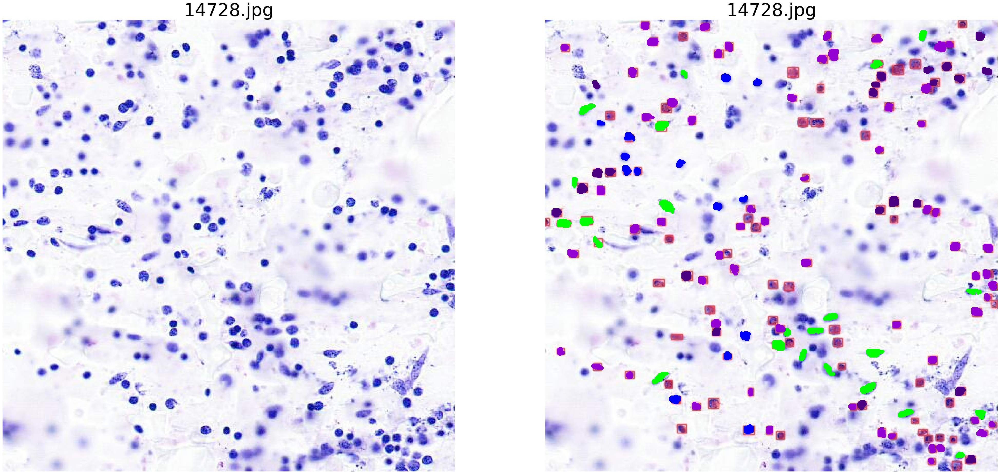

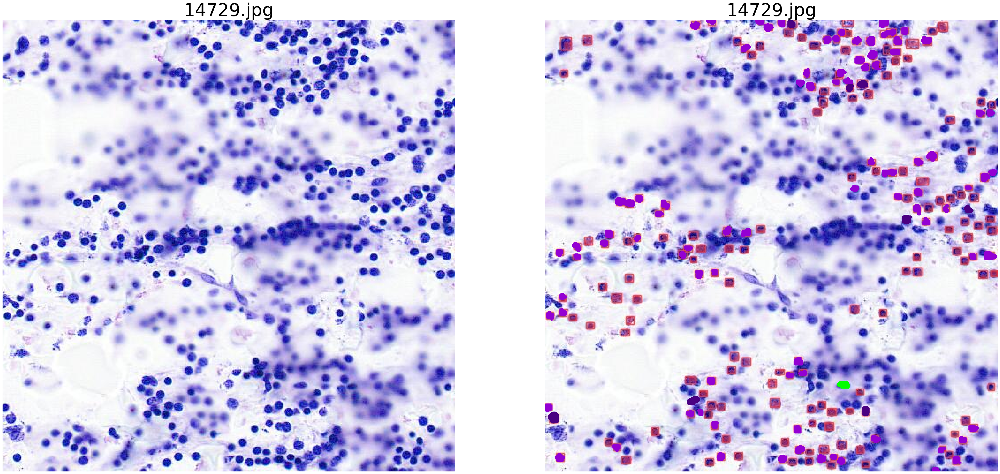

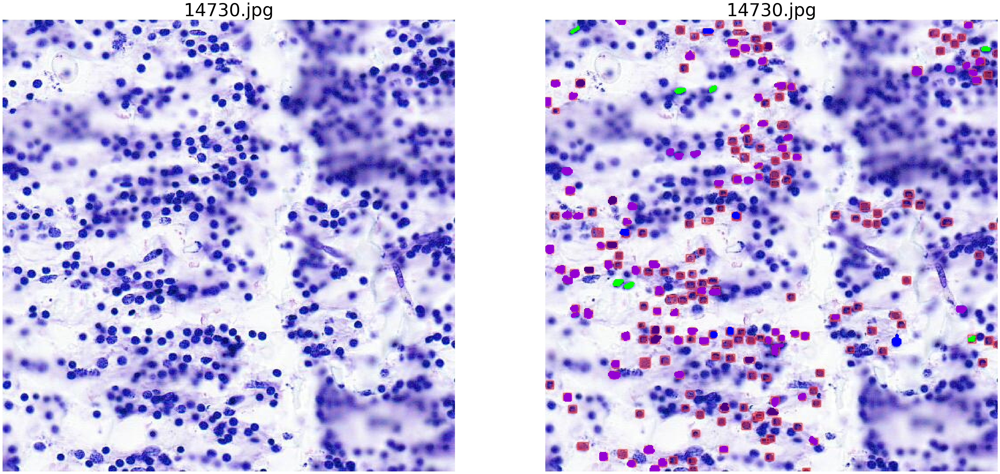

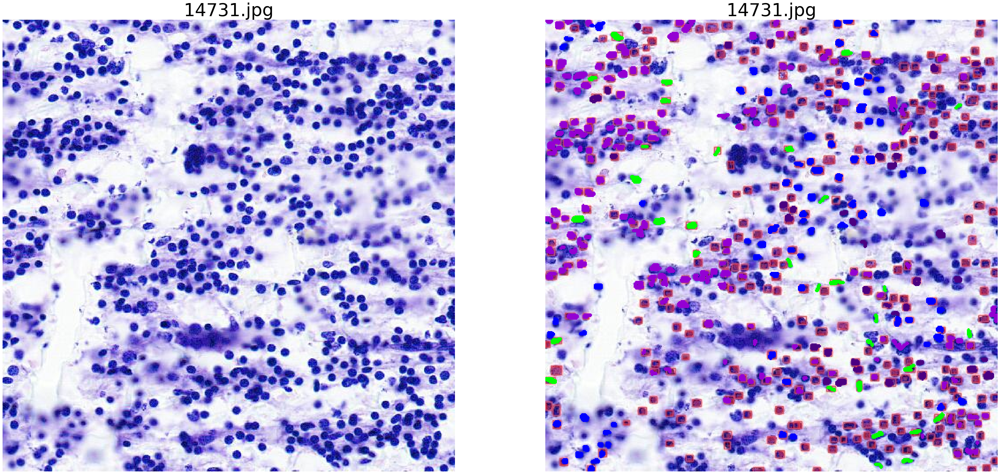

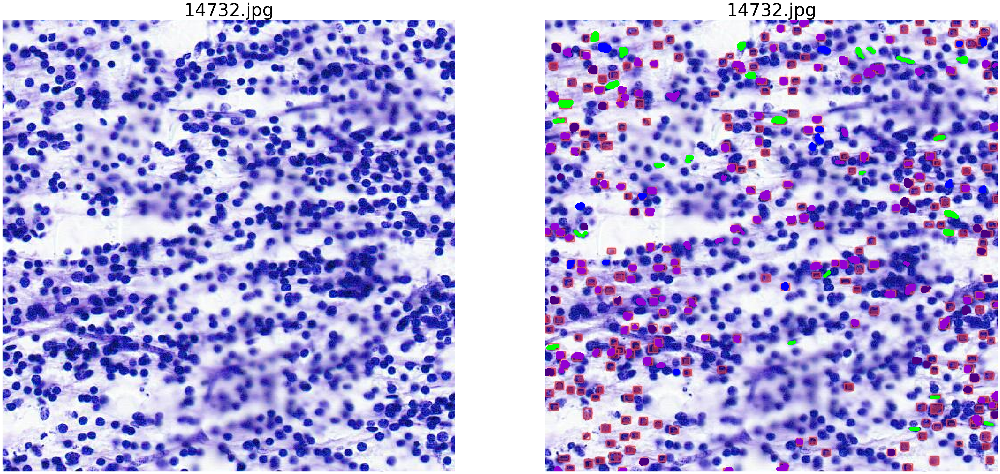

...

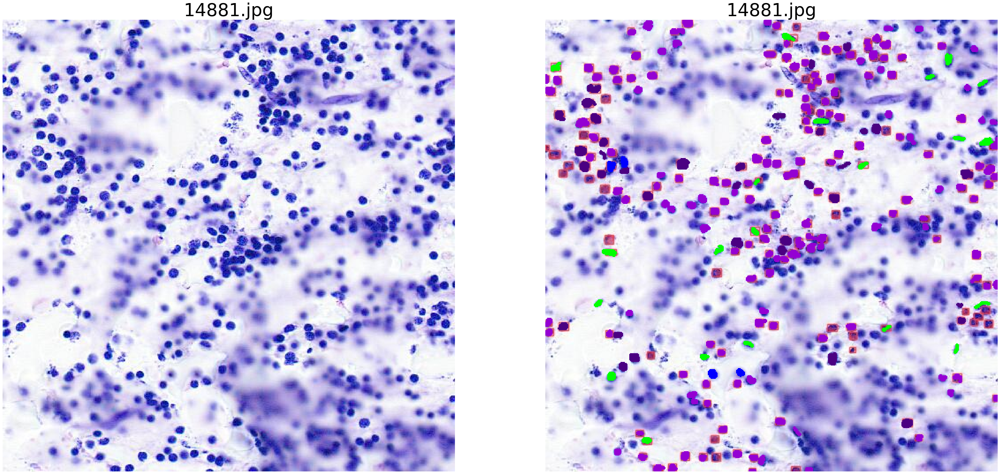

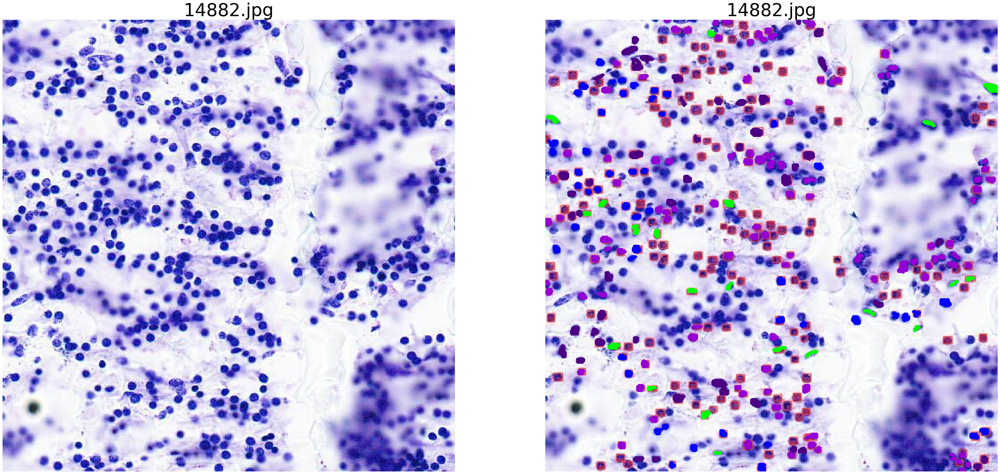

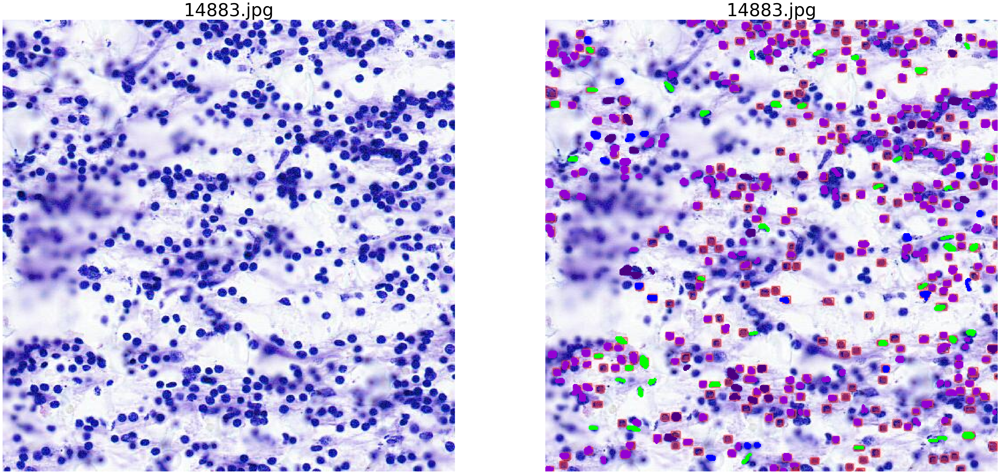

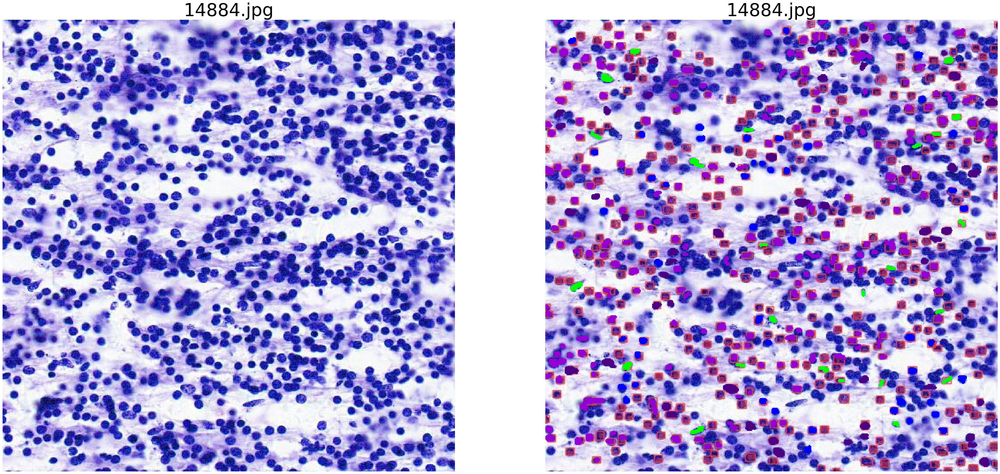

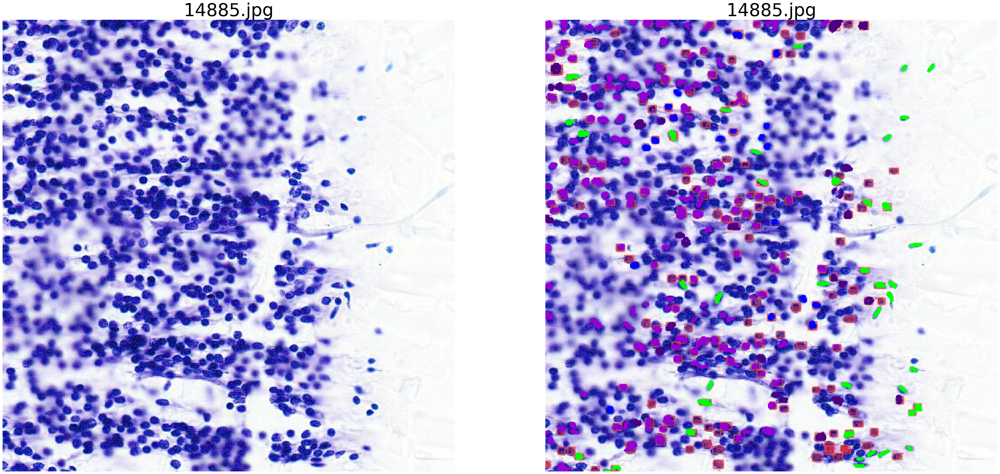

In [21]:
for imgfile in image_list:
    img_ = imread(os.path.join(imgdir,imgfile))
    annot = imread(os.path.join(maskdir,imgfile[:-4]+'_annotated.png'))
    yolo_out = imread(os.path.join(yolo_out_dir,imgfile))
    plt.figure(figsize=(50,100))

    plt.subplot(1,2,1)
    plt.title(imgfile,fontsize=50)
    plt.axis('off')
    plt.imshow(img_)

    plt.subplot(1,2,2)
    plt.axis('off')
    plt.title(imgfile,fontsize=50)
    plt.imshow(yolo_out)
    plt.imshow(annot)